In [1]:
from IPython import get_ipython


 I'll summarise here the insights from my brief data analyses and whatever is shared in public discussions.
 This is still highly under progress and will be updated when possible.

 Quoting Chris Balbach (our Competition Host):
 > Consider the scenario laid out in this diagram. This competition simulates the modelling challenge presented at the end of the timeline when measured energy and weather conditions are known and the adjusted baseline energy must be calculated.
 ![Energy Consumption/Demand vs Time](https://www.mdpi.com/make/make-01-00056/article_deploy/html/images/make-01-00056-g001-550.jpg)
 > For further details, I recommend reading [this paper](https://www.mdpi.com/2504-4990/1/3/56) by Clayton Miller.

 We are actually using data from 2016 to predict the demand for both 2017 and 2018, which is a hard task. However, other public kernels have showed that you can give a relatively good estimate even with a very simple linear model.

In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os, gc
import random
import datetime

from tqdm import tqdm_notebook as tqdm

# matplotlib and seaborn for plotting
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

# import plotly.offline as py
# py.init_notebook_mode(connected=True)
# from plotly.offline import init_notebook_mode, iplot
# init_notebook_mode(connected=True)
# import plotly.graph_objs as go
# import plotly.offline as offline
# offline.init_notebook_mode()

from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import KFold, StratifiedKFold
from sklearn import preprocessing
from sklearn.externals import joblib

import lightgbm as lgb



C:\Users\si_no\Anaconda3\lib\site-packages\sklearn\externals\joblib\__init__.py:15: DeprecationWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=DeprecationWarning)


In [3]:
path = './input'
# Input data files are available in the "../input/" directory.
for dirname, _, filenames in os.walk(path):
    for filename in filenames:
        print(os.path.join(dirname, filename))


./input\building_metadata.csv
./input\sample_submission.csv
./input\test.csv
./input\test.pickle
./input\train.csv
./input\train.pickle
./input\weather_test.csv
./input\weather_train.csv


 # Load data and display samples

In [4]:
unimportant_cols = ['wind_direction', 'wind_speed', 'sea_level_pressure']
target = 'meter_reading'
def load_data(source='train', path=path):#testまたはtrainを読み込む
    if not os.path.exists(f'{path}/{source}.pickle'):#pickle
        assert source in ['train', 'test']
        building = pd.read_csv(f'{path}/building_metadata.csv', dtype={'building_id':np.uint16, 'site_id':np.uint8})
        weather  = pd.read_csv( \
                        f'{path}/weather_{source}.csv', parse_dates=['timestamp'], \
                        dtype={'site_id':np.uint8, 'air_temperature':np.float16, 'cloud_coverage':np.float16, 'dew_temperature':np.float16, 'precip_depth_1_hr':np.float16}, \
                        usecols=lambda c: c not in unimportant_cols
                    )
        df = pd.read_csv(f'{path}/{source}.csv', dtype={'building_id':np.uint16, 'meter':np.uint8}, parse_dates=['timestamp'])
        df = df.merge(building, on='building_id', how='left')#building_metadata.csvと結合
        df = df.merge(weather, on=['site_id', 'timestamp'], how='left')#wether_(train/test).csvと結合
        joblib.dump(df, f'{path}/{source}.pickle', compress=True)
    else:
        df=joblib.load(f'{path}/{source}.pickle')
    return df
train = load_data('train')
train.sample(7)


,building_id,meter,timestamp,meter_reading,site_id,primary_use,square_feet,year_built,floor_count,air_temperature,cloud_coverage,dew_temperature,precip_depth_1_hr
19753008,1381,2,2016-12-23 19:00:00,1262.520,15,Office,84615,1963.0,NaN,3.900391,0.0,-5.000000,NaN
13823157,752,1,2016-09-09 05:00:00,265.535,6,Public services,38671,NaN,NaN,25.593750,0.0,21.093750,0.0
18146106,1030,1,2016-11-24 22:00:00,0.000,11,Education,68030,NaN,NaN,-0.899902,NaN,-1.700195,NaN
13209534,1168,2,2016-08-29 08:00:00,35250.000,13,Office,577101,NaN,NaN,22.203125,2.0,20.000000,0.0
3554096,361,0,2016-03-07 23:00:00,12.970,3,Public services,13224,1965.0,NaN,17.203125,NaN,1.700195,0.0
431569,1302,3,2016-01-08 19:00:00,241.866,14,Office,90411,NaN,NaN,6.101562,NaN,-1.099609,0.0
19139331,65,0,2016-12-13 00:00:00,134.123,0,Lodging/residential,53130,2001.0,NaN,24.406250,4.0,17.796875,0.0


 ### Test data

In [5]:
test = load_data('test')
test.sample(7)


,row_id,building_id,meter,timestamp,site_id,primary_use,square_feet,year_built,floor_count,air_temperature,cloud_coverage,dew_temperature,precip_depth_1_hr
8565695,8565695,379,0,2017-01-24 08:00:00,3,Entertainment/public assembly,7675,NaN,NaN,3.900391,NaN,2.800781,-1.0
39589524,39589524,1417,2,2018-02-13 14:00:00,15,Lodging/residential,40451,1975.0,NaN,-5.601562,NaN,-8.898438,-1.0
30059123,30059123,1130,1,2018-03-24 13:00:00,13,Education,280225,NaN,NaN,-1.700195,NaN,-8.898438,0.0
39262760,39262760,1412,0,2017-12-17 04:00:00,15,Lodging/residential,39538,1953.0,NaN,-5.601562,NaN,-8.898438,NaN
38564181,38564181,1375,1,2017-08-22 07:00:00,15,Office,115288,1957.0,NaN,18.296875,0.0,17.796875,NaN
39910430,39910430,1374,1,2018-04-08 14:00:00,15,Office,159662,1956.0,NaN,-2.800781,NaN,-7.800781,-1.0
15312727,15312727,740,0,2017-08-26 17:00:00,5,Education,37975,1976.0,1.0,19.000000,0.0,14.000000,NaN


 # EDA and sample statistics

In [6]:
print(f'Training from {train.timestamp.min()} to {train.timestamp.max()}, and predicting from {test.timestamp.min()} to {test.timestamp.max()}')



Training from 2016-01-01 00:00:00 to 2016-12-31 23:00:00, and predicting from 2017-01-01 00:00:00 to 2018-12-31 23:00:00


count    2.021610e+07
mean     2.117121e+03
std      1.532356e+05
min      0.000000e+00
25%      1.830000e+01
50%      7.877500e+01
75%      2.679840e+02
max      2.190470e+07
Name: meter_reading, dtype: float64

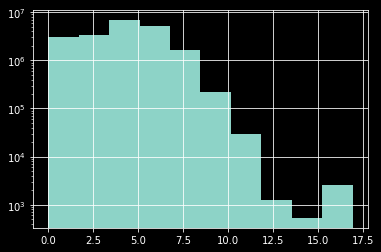

In [7]:
# target's log-log histogram:
ax = np.log1p(train.meter_reading).hist()#自然対数、真数に+1、多分1未満だとバグるから？
ax.set_yscale('log')

# describe raw values first
train.meter_reading.describe()



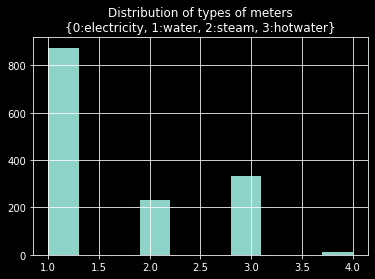

In [8]:
# check the distribution in the types of meters
meters = train.groupby('building_id').meter.nunique()
plt.title('Distribution of types of meters\n{0:electricity, 1:water, 2:steam, 3:hotwater}') # from the official starter kernel
_ = meters.hist()
# from the graphs it looks like steam and hotwater are reversed (e.g.: 3:steam, 2:hotwater) but that shouldn't make any difference to the model


 ### display a single time series (notice measurement errors and discontinuities)

In [9]:
#例として4つのメーターがあるID1258をピックアップする
building_id = 1258  # a building with all 4 meters
#4つのメーターがある行のメータ値のユニークな値の数＝電気水道蒸気温水の4つ
meters = train[train['building_id'] == building_id].meter.nunique()
print('meters:',meters)


meters:4


In [10]:
#同じビル、４つのメーター、違う日のデータがたくさんある
display(train[train['building_id'] == building_id])


,building_id,meter,timestamp,meter_reading,site_id,primary_use,square_feet,year_built,floor_count,air_temperature,cloud_coverage,dew_temperature,precip_depth_1_hr
1881,1258,0,2016-01-01 00:00:00,910.464,14,Education,273234,NaN,NaN,NaN,NaN,NaN,NaN
1882,1258,1,2016-01-01 00:00:00,2509.150,14,Education,273234,NaN,NaN,NaN,NaN,NaN,NaN
1883,1258,2,2016-01-01 00:00:00,2923.120,14,Education,273234,NaN,NaN,NaN,NaN,NaN,NaN
1884,1258,3,2016-01-01 00:00:00,891.480,14,Education,273234,NaN,NaN,NaN,NaN,NaN,NaN
4177,1258,0,2016-01-01 01:00:00,916.448,14,Education,273234,NaN,NaN,5.601562,0.0,-0.600098,0.0
4178,1258,1,2016-01-01 01:00:00,1957.440,14,Education,273234,NaN,NaN,5.601562,0.0,-0.600098,0.0
4179,1258,2,2016-01-01 01:00:00,13590.600,14,Education,273234,NaN,NaN,5.601562,0.0,-0.600098,0.0
6473,1258,0,2016-01-01 02:00:00,934.457,14,Education,273234,NaN,NaN,5.601562,4.0,-0.600098,0.0
6474,1258,1,2016-01-01 02:00:00,2000.400,14,Education,273234,NaN,NaN,5.601562,4.0,-0.600098,0.0
6475,1258,2,2016-01-01 02:00:00,3079.990,14,Education,273234,NaN,NaN,5.601562,4.0,-0.600098,0.0


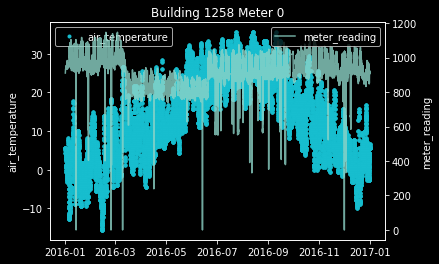

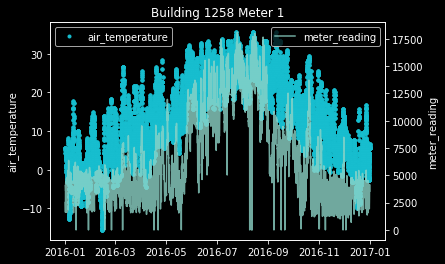

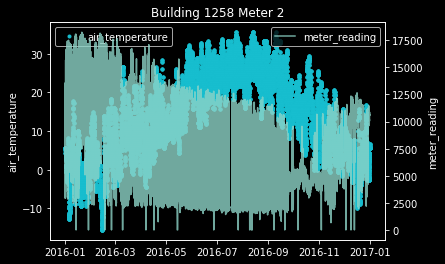

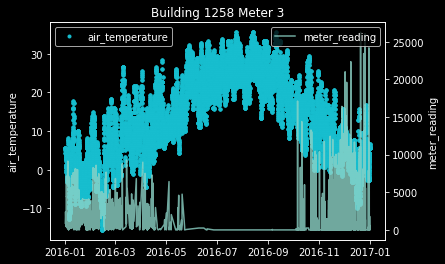

In [11]:
#点が気温、線がメータ値、0電気1水道2蒸気3温水
for meter in range(meters):
    fig, ax = plt.subplots()
    plt.title(f'Building {building_id} Meter {meter}')
    ax2 = ax.twinx()
    # plot meter_reading
    idx = (train['building_id'] == building_id) & (train['meter'] == meter)
    dates = matplotlib.dates.date2num(train.loc[idx, 'timestamp'])
    ax2.plot_date(dates, train.loc[idx, 'meter_reading'], '-', label='meter_reading', alpha=0.8)
    # plot air_temperature
    dates = matplotlib.dates.date2num(train.loc[train['building_id'] == building_id, 'timestamp'])
    ax.plot_date(dates, train.loc[train['building_id'] == building_id, 'air_temperature'], '.', color='tab:cyan', label='air_temperature')
    ax.set_ylabel('air_temperature'); ax2.set_ylabel('meter_reading')
    ax.legend(loc='upper left'); ax2.legend(loc='upper right')


 ### now let's see what's the expected prediction in the test set for the same building
 ### 右下の黄色い棒のところが予測しなければいけないテストデータ

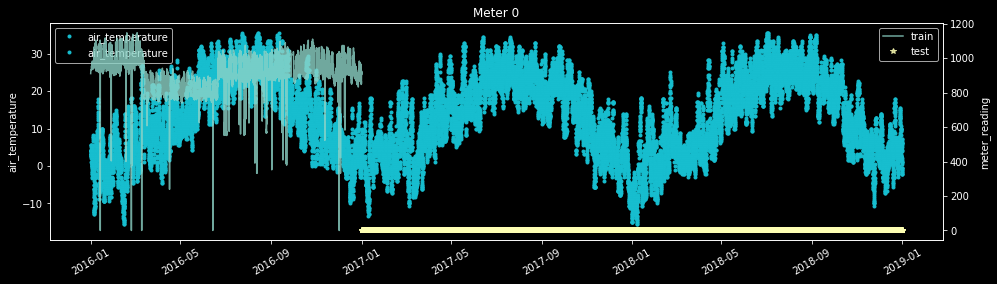

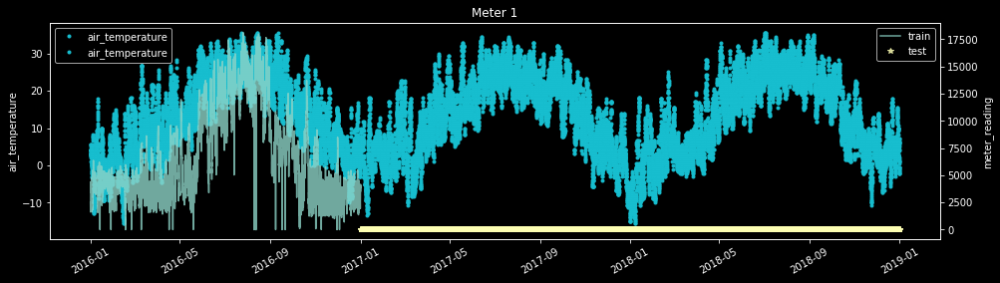

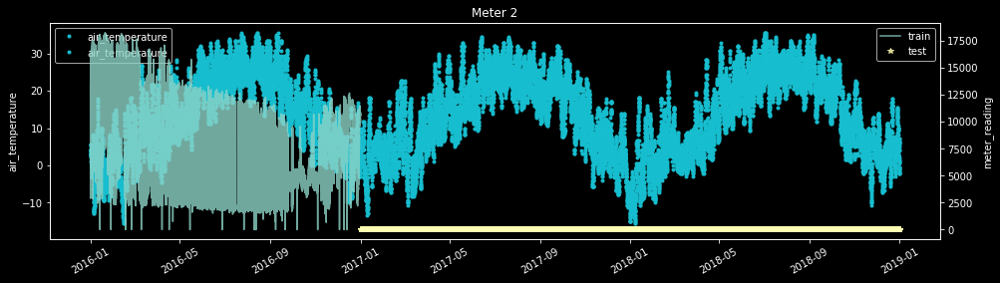

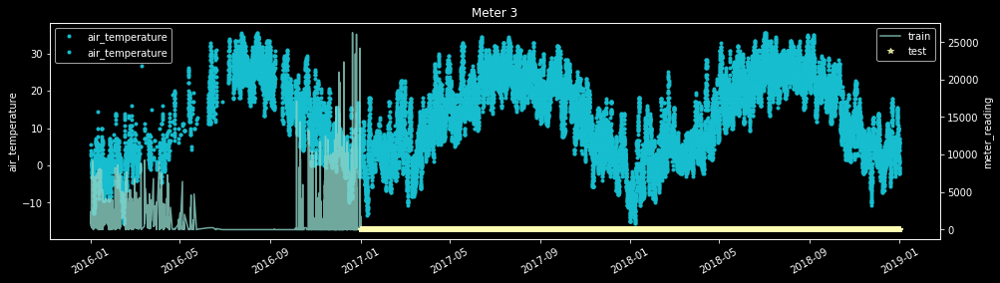

In [12]:
for meter in range(meters):
    train_sample = train[(train['building_id'] == building_id) & (train['meter'] == meter)]  # same train sample as above

    test['meter_reading'] = 0.0
    test_sample = test[(test['building_id'] == building_id) & (test['meter'] == meter)]  # and the same meter in the test set

    fig, ax = plt.subplots(figsize=(16,4))
    plt.title(f'Meter {meter}')
    ax.xaxis.set_tick_params(rotation=30, labelsize=10)
    ax2 = ax.twinx()

    # plot training sample
    dates = matplotlib.dates.date2num(train_sample['timestamp'])
    ax2.plot_date(dates, train_sample['meter_reading'], '-', label='train', alpha=0.8)
    ax.plot_date(dates, train_sample['air_temperature'], '.', color='tab:cyan', label='air_temperature')

    # plot test sample
    dates = matplotlib.dates.date2num(test_sample['timestamp'])
    ax2.plot_date(dates, test_sample['meter_reading'], '*', label='test', alpha=0.8)
    ax.plot_date(dates, test_sample['air_temperature'], '.', color='tab:cyan', label='air_temperature')

    ax.set_ylabel('air_temperature'); ax2.set_ylabel('meter_reading')
    ax.legend(loc='upper left'); ax2.legend(loc='upper right')
    del train_sample; del test_sample; del dates



In [13]:
# some feature stats
train.describe()



,building_id,meter,meter_reading,site_id,square_feet,year_built,floor_count,air_temperature,cloud_coverage,dew_temperature,precip_depth_1_hr
count,2.021610e+07,2.021610e+07,2.021610e+07,2.021610e+07,2.021610e+07,8.088455e+06,3.506933e+06,2.011944e+07,11390735.0,2.011596e+07,16467077.0
mean,7.992780e+02,6.624412e-01,2.117121e+03,7.992232e+00,1.077830e+05,1.968277e+03,4.184848e+00,NaN,NaN,NaN,NaN
std,4.269133e+02,9.309921e-01,1.532356e+05,5.099060e+00,1.171424e+05,3.020815e+01,4.008277e+00,0.000000e+00,0.0,0.000000e+00,NaN
min,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.830000e+02,1.900000e+03,1.000000e+00,-2.890625e+01,0.0,-3.500000e+01,-1.0
25%,3.930000e+02,0.000000e+00,1.830000e+01,3.000000e+00,3.252700e+04,1.951000e+03,1.000000e+00,8.601562e+00,0.0,0.000000e+00,0.0
50%,8.950000e+02,0.000000e+00,7.877500e+01,9.000000e+00,7.270900e+04,1.969000e+03,3.000000e+00,1.670312e+01,0.0,8.898438e+00,0.0
75%,1.179000e+03,1.000000e+00,2.679840e+02,1.300000e+01,1.391130e+05,1.993000e+03,6.000000e+00,2.409375e+01,4.0,1.609375e+01,0.0
max,1.448000e+03,3.000000e+00,2.190470e+07,1.500000e+01,8.750000e+05,2.017000e+03,2.600000e+01,4.718750e+01,9.0,2.609375e+01,343.0


In [14]:
# the counts above expose the missing data (Should we drop or refill the missing data?)
print("trainのNANじゃない割合:")
data_ratios = train.count()/len(train)#count()はデータの個数をカウント、nanはカウントされない
data_ratios



trainのNANじゃない割合:


building_id          1.000000
meter                1.000000
timestamp            1.000000
meter_reading        1.000000
site_id              1.000000
primary_use          1.000000
square_feet          1.000000
year_built           0.400100
floor_count          0.173472
air_temperature      0.995219
cloud_coverage       0.563449
dew_temperature      0.995047
precip_depth_1_hr    0.814553
dtype: float64

In [15]:
# Is the same happening in the test set? Yes
print("testのNANじゃない割合:")
test.count()/len(test)



testのNANじゃない割合:


row_id               1.000000
building_id          1.000000
meter                1.000000
timestamp            1.000000
site_id              1.000000
primary_use          1.000000
square_feet          1.000000
year_built           0.410084
floor_count          0.173950
air_temperature      0.994678
cloud_coverage       0.531336
dew_temperature      0.993745
precip_depth_1_hr    0.812901
meter_reading        1.000000
dtype: float64

In [16]:
# we can refill with averages
train.loc[:, data_ratios < 1.0].mean()#NaNを含む列の値の平均


year_built           1968.276736
floor_count             4.184848
air_temperature        15.987972
cloud_coverage          1.900423
dew_temperature         7.747397
precip_depth_1_hr       0.796416
dtype: float64

 # Preprocess data

In [17]:
class ASHRAE3Preprocessor(object):
    @classmethod
    def fit(cls, df, data_ratios=data_ratios):#nanがあるものの平均とラベルエンコーダを定義
        cls.avgs = df.loc[:,data_ratios < 1.0].mean()
        cls.pu_le = LabelEncoder()
        cls.pu_le.fit(df["primary_use"])

    @classmethod
    def transform(cls, df):
        df = df.fillna(cls.avgs) # refill NAN with averages
        #primary_useは施設の利用方法
        df['primary_use'] = np.uint8(cls.pu_le.transform(df['primary_use']))  # encode labels

        # expand datetime into its components
        df['hour'] = np.uint8(df['timestamp'].dt.hour)#dt=dataframeの時系列変換メソッド
        df['day'] = np.uint8(df['timestamp'].dt.day)
        df['weekday'] = np.uint8(df['timestamp'].dt.weekday)
        df['month'] = np.uint8(df['timestamp'].dt.month)
        df['year'] = np.uint8(df['timestamp'].dt.year-2000)
        
        # parse and cast columns to a smaller type
        df.rename(columns={"square_feet": "log_square_feet"}, inplace=True)
        df['log_square_feet'] = np.float16(np.log(df['log_square_feet']))#square_feetの対数を取る
        df['year_built'] = np.uint8(df['year_built']-1900)#年数から1900を引く
        df['floor_count'] = np.uint8(df['floor_count'])#uintに
        
        # remove redundant columns
        for col in df.columns:
            if col in ['timestamp', 'row_id']:
                del df[col]#timestampとrow_idを削除
    
        # extract target column
        #ターゲット列を変換
        if 'meter_reading' in df.columns:
            df['meter_reading'] = np.log1p(df['meter_reading']).astype(np.float32) # comp metric uses log errors
        return df


In [18]:
ASHRAE3Preprocessor.fit(train)
train = ASHRAE3Preprocessor.transform(train)
train.sample(7)



,building_id,meter,meter_reading,site_id,primary_use,log_square_feet,year_built,floor_count,air_temperature,cloud_coverage,dew_temperature,precip_depth_1_hr,hour,day,weekday,month,year
14048049,1344,0,5.629239,15,0,11.742188,74,4,10.601562,0.000000,8.898438,0.796387,4,13,1,9,16
2225610,585,0,5.382199,4,9,11.796875,49,7,12.796875,2.000000,9.398438,0.000000,8,10,2,2,16
15387007,886,2,3.106826,9,0,11.156250,68,4,32.187500,0.000000,20.000000,0.000000,21,6,3,10,16
19140288,799,0,8.494720,7,0,13.171875,76,26,-3.099609,1.900391,-3.800781,0.796387,0,13,1,12,16
11384498,1303,2,6.907352,14,3,12.203125,68,4,23.296875,1.900391,17.203125,0.000000,10,27,2,7,16
19754844,1165,0,2.065216,13,6,10.273438,68,4,0.600098,1.900391,-0.600098,-1.000000,20,23,4,12,16
9680515,379,0,3.479700,3,1,8.945312,68,4,22.796875,2.000000,15.601562,0.000000,3,27,0,6,16


In [19]:
train.dtypes


building_id           uint16
meter                  uint8
meter_reading        float32
site_id                uint8
primary_use            uint8
log_square_feet      float16
year_built             uint8
floor_count            uint8
air_temperature      float16
cloud_coverage       float16
dew_temperature      float16
precip_depth_1_hr    float16
hour                   uint8
day                    uint8
weekday                uint8
month                  uint8
year                   uint8
dtype: object

 # Feature ranked correlation

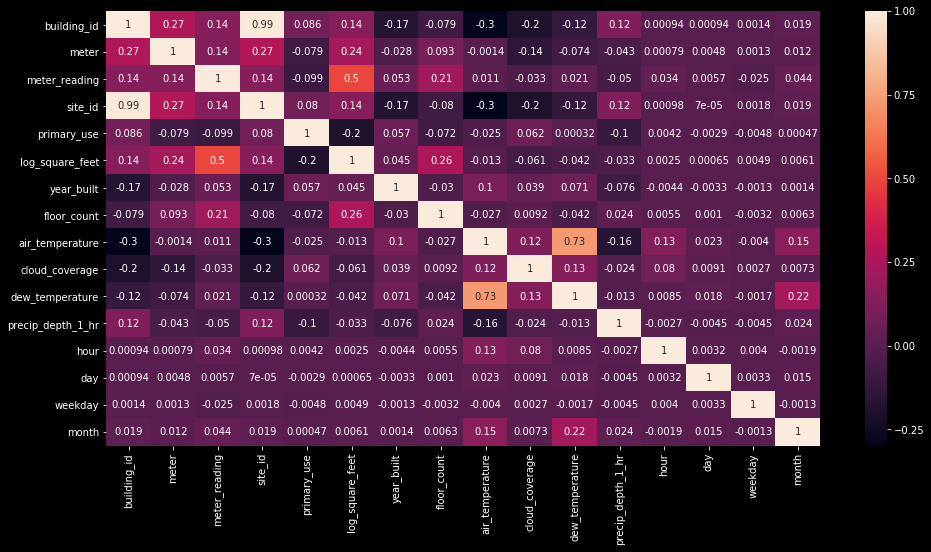

In [20]:
fig, ax = plt.subplots(figsize=(16,8))
# use a ranked correlation to catch nonlinearities
corr = train[[col for col in train.columns if col != 'year']].sample(100100).corr(method='spearman')
_ = sns.heatmap(corr, annot=True, xticklabels=corr.columns.values, yticklabels=corr.columns.values)


 # Train K folds

In [21]:
# force the model to use the weather data instead of dates, to avoid overfitting to the past history
# 指定した4つの列以外の列を学習に使う（落とさない）
features = [col for col in train.columns if col not in [target, 'year', 'month', 'day']]

##########################################以下は学習

In [22]:
folds = 4
seed = 42
kf = StratifiedKFold(n_splits=folds, shuffle=True, random_state=seed)
# oof_pred = np.zeros(train.shape[0])  # out of fold predictions
models = []

## stratify data by building_id
for tr_idx, val_idx in tqdm(kf.split(train, train['building_id']), total=folds):
    def fit_regressor(tr_idx, val_idx):
        tr_x, tr_y = train[features].iloc[tr_idx], train[target][tr_idx]#有効な列の値と答え
        vl_x, vl_y = train[features].iloc[val_idx], train[target][val_idx]#上のバリデーション
        print({'train size':len(tr_x), 'eval size':len(vl_x)})
        tr_data = lgb.Dataset(tr_x, label=tr_y)
        vl_data = lgb.Dataset(vl_x, label=vl_y)
        clf = lgb.LGBMRegressor(n_estimators=6000,
                                learning_rate=0.28,
                                feature_fraction=0.9,
                                subsample=0.2,  # batches of 20% of the data
                                subsample_freq=1,
                                num_leaves=20,
                                metric='rmse')
        clf.fit(tr_x, tr_y,
                eval_set=[(vl_x, vl_y)],
                early_stopping_rounds=50,
                verbose=200)
#         oof_pred[val_idx] += clf.predict(vl_x, num_iteration=clf.best_iteration_)
        return clf
    clf = fit_regressor(tr_idx, val_idx)
    models.append(clf)
#     break ### TODO: remove to run next folds
    
gc.collect()


{'train size': 15161663, 'eval size': 5054437}
Training until validation scores don't improve for 50 rounds.
[200]	valid_0's rmse: 1.19025
[400]	valid_0's rmse: 1.09883
[600]	valid_0's rmse: 1.05352
[800]	valid_0's rmse: 1.02506
[1000]	valid_0's rmse: 1.00544
[1200]	valid_0's rmse: 0.990348
[1400]	valid_0's rmse: 0.977946
[1600]	valid_0's rmse: 0.965896
[1800]	valid_0's rmse: 0.957866
[2000]	valid_0's rmse: 0.951186
[2200]	valid_0's rmse: 0.945163
[2400]	valid_0's rmse: 0.939288
[2600]	valid_0's rmse: 0.933694
[2800]	valid_0's rmse: 0.928775
[3000]	valid_0's rmse: 0.924535
[3200]	valid_0's rmse: 0.920427
[3400]	valid_0's rmse: 0.916763
[3600]	valid_0's rmse: 0.914132
[3800]	valid_0's rmse: 0.911521
[4000]	valid_0's rmse: 0.908359
[4200]	valid_0's rmse: 0.906056
[4400]	valid_0's rmse: 0.903291
[4600]	valid_0's rmse: 0.900754
[4800]	valid_0's rmse: 0.898264
[5000]	valid_0's rmse: 0.896549
[5200]	valid_0's rmse: 0.894689
[5400]	valid_0's rmse: 0.893181
[5600]	valid_0's rmse: 0.891313
[580

330

 # Feature importance

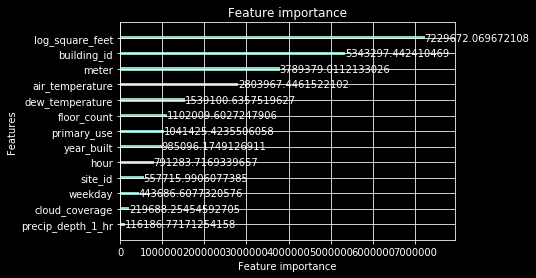

In [23]:
_ = lgb.plot_importance(models[0], importance_type='gain')



In [24]:
# calculate the mean feature importance, so that we can update 'unimportant_cols' above
feature_importance = np.mean([m._Booster.feature_importance(importance_type='gain') for m in models], axis=0)
sorted(zip(feature_importance, train.columns), reverse=True)


[(7278706.790577054, 'primary_use'),
 (5253196.225911856, 'building_id'),
 (3809760.009500146, 'meter'),
 (2703161.3533076644, 'floor_count'),
 (1595831.5142070055, 'cloud_coverage'),
 (1085063.991961062, 'year_built'),
 (1071480.735162437, 'site_id'),
 (970892.5315460563, 'log_square_feet'),
 (799984.0350946188, 'precip_depth_1_hr'),
 (618543.8362759948, 'meter_reading'),
 (445383.86126184464, 'hour'),
 (219446.29213798046, 'air_temperature'),
 (122865.62858819962, 'dew_temperature')]

 # Check prediction

In [25]:
# load and pre-process test data
test = ASHRAE3Preprocessor.transform(test)
test.sample(7)


,building_id,meter,site_id,primary_use,log_square_feet,year_built,floor_count,air_temperature,cloud_coverage,dew_temperature,precip_depth_1_hr,meter_reading,hour,day,weekday,month,year
36712376,1293,3,14,6,10.851562,68,4,9.398438,1.900391,0.000000,0.000000,0.0,16,22,0,10,18
34497341,1284,2,14,0,13.000000,68,4,14.398438,1.900391,13.296875,36.000000,0.0,2,6,2,12,17
11863101,433,0,3,1,10.046875,68,4,24.406250,1.900391,19.406250,0.000000,0.0,19,9,5,6,18
41246199,1382,2,15,9,12.398438,65,4,2.199219,1.900391,-1.099609,0.796387,0.0,16,19,0,11,18
9147579,563,0,3,6,10.351562,68,4,13.296875,1.900391,12.203125,15.000000,0.0,19,22,5,4,17
24449248,921,1,9,1,12.476562,68,4,7.199219,1.900391,5.000000,2.000000,0.0,20,15,0,10,18
26674924,1063,0,12,0,10.968750,68,4,17.093750,1.000000,13.101562,0.796387,0.0,15,10,2,10,18


 ### now let's revisit the same meter we had initially looked at, and check the predictions for each fold

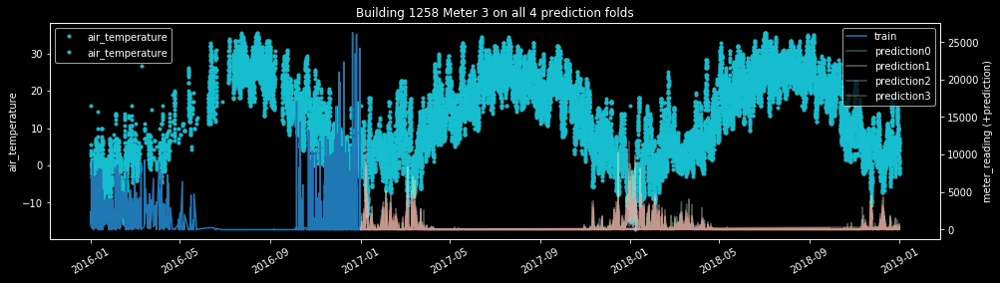

In [26]:
def recover_timestamp(x):
    ''' reassemble timestamp using date components '''
    return datetime.datetime.strptime(f'{x.year}-{x.month}-{x.day} {x.hour}', '%y-%m-%d %H')

fig, ax = plt.subplots(figsize=(16,4))
plt.title(f'Building {building_id} Meter {meter} on all {folds} prediction folds')
ax.xaxis.set_tick_params(rotation=30, labelsize=10)
ax2 = ax.twinx()

train_sample = train[(train['building_id'] == building_id) & (train['meter'] == meter)]  # same training sample as before
test_sample = test[(test['building_id'] == building_id) & (test['meter'] == meter)]   # and the same meter in the test set

# plot training sample
dates = matplotlib.dates.date2num(train_sample[['year', 'month', 'day', 'hour']].apply(recover_timestamp, axis=1))
ax.plot_date(dates, train_sample['air_temperature'], '.', color='tab:cyan', label='air_temperature')
ax2.plot_date(dates, np.expm1(train_sample['meter_reading']), '-', color='tab:blue', label='train')

# plot prediction sample
dates = matplotlib.dates.date2num(test_sample[['year', 'month', 'day', 'hour']].apply(recover_timestamp, axis=1))
ax.plot_date(dates, test_sample['air_temperature'], '.', color='tab:cyan', label='air_temperature')
for i,model in enumerate(models):
    ax2.plot_date(dates, np.expm1(model.predict(test_sample[features])), '-', label=f'prediction{i}', alpha=0.4)

ax.set_ylabel('air_temperature'); ax2.set_ylabel('meter_reading (+prediction)')
ax.legend(loc='upper left'); ax2.legend(loc='upper right')
_ = plt.show()

del test_sample; del train_sample
_ = gc.collect()



In [27]:
# # Check if all test buildings and meters are the same as in the training data
# train_buildings = np.unique(train[['building_id', 'meter']].values, axis=0)
# # del train; gc.collect()

# test_buildings  = np.unique(test[['building_id', 'meter']].values, axis=0)

# print(len(train_buildings), len(test_buildings))
# [b for b in test_buildings if b not in train_buildings]


 # Test Inference and Submission

In [28]:
# split test data into batches
set_size = len(test)
iterations = 50
batch_size = set_size // iterations

print(set_size, iterations, batch_size)
assert set_size == iterations * batch_size



4169760050833952


In [29]:
meter_reading = []
for i in tqdm(range(iterations)):
    pos = i*batch_size
    fold_preds = [np.expm1(model.predict(test[features].iloc[pos : pos+batch_size])) for model in models]
    meter_reading.extend(np.mean(fold_preds, axis=0))

print(len(meter_reading))
assert len(meter_reading) == set_size



41697600


 ### Save submission

In [30]:
submission = pd.read_csv(f'{path}/sample_submission.csv')
submission['meter_reading'] = np.clip(meter_reading, a_min=0, a_max=None) # clip min at zero



In [31]:
submission.to_csv('submission.csv', index=False)
submission.head(9)



,row_id,meter_reading
0,0,2.410373
1,1,1.023007
2,2,0.122059
3,3,6.975909
4,4,9.129081
5,5,0.657048
6,6,4.196970
7,7,2.908662
8,8,10.056093


count    4.169760e+07
mean     5.033323e+02
std      1.831025e+04
min      0.000000e+00
25%      1.867351e+01
50%      6.951723e+01
75%      2.215200e+02
max      2.220537e+07
Name: meter_reading, dtype: float64

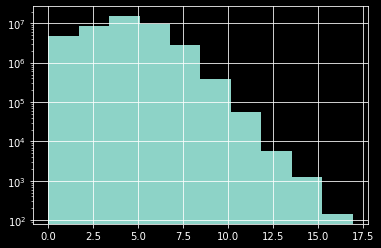

In [32]:
# prediction's log-log histogram:
plt.yscale('log')
_ = np.log1p(submission['meter_reading']).hist()

# describe raw submission
submission['meter_reading'].describe()


